In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import rotate

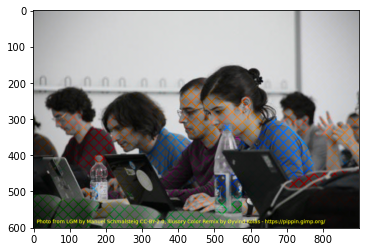

In [4]:
path = "a\\"
img_name = "diagonal_gird.png"

img = cv2.imread(path+img_name)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

plt.imshow(img)

# A

In [10]:
def get_magnitude(inp_img, name):
    print(name)
    plt.figure(figsize=(25, 7))
    fontsize = 15
    fg_color = 'black'
    I_color = 'green'
    font_dict_1 = {'fontsize': fontsize, 'color':fg_color, 'fontweight':'bold'}
    font_dict_2 = {'fontsize': fontsize, 'color':I_color, 'fontweight':'bold'}
    magnitudes = []
    # we have 3 channels. So do dft in each channel seperately.
    for i in range(3): 
        dft = cv2.dft(np.float32(inp_img[:, :, i]),flags = cv2.DFT_COMPLEX_OUTPUT)
        dft_shift = np.fft.fftshift(dft)

        magnitude_spectrum = 20*np.log(cv2.magnitude(dft_shift[:,:,0],dft_shift[:,:,1]))
        magnitudes.append(magnitude_spectrum)
        plt.subplot(1,6,2*i+1),plt.imshow(inp_img[:, :, i], cmap='gray')
        plt.title('Channel '+str(i), fontdict=font_dict_1), plt.xticks([]), plt.yticks([])
        plt.subplot(1,6,2*i+2),plt.imshow(magnitude_spectrum, cmap = 'gray')
        plt.title('Magnitude Spectrum', fontdict=font_dict_2), plt.xticks([]), plt.yticks([])
    # plt.show()
    plt.savefig("b/"+name+"_amplitude.png")
    return magnitudes
   

diagonal_gird_rgb
diagonal_gird_hsv
diagonal_gird_YCbCr
diagonal_gird_lab
dot_grid_rgb
dot_grid_hsv
dot_grid_YCbCr
dot_grid_lab
orthogonal_lines_rgb
orthogonal_lines_hsv
orthogonal_lines_YCbCr
orthogonal_lines_lab


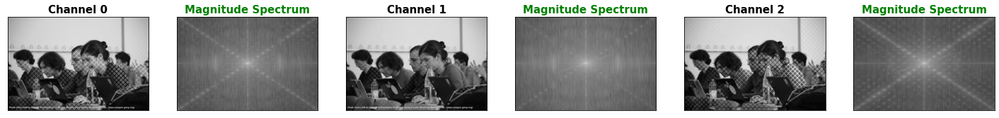

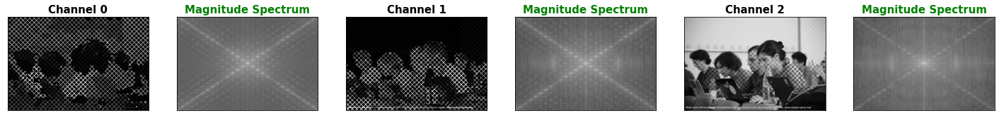

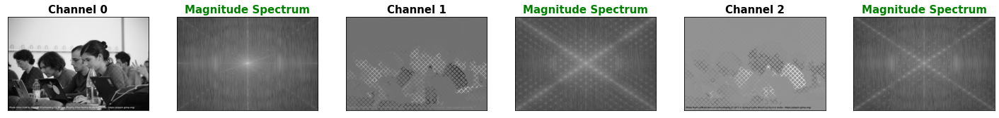

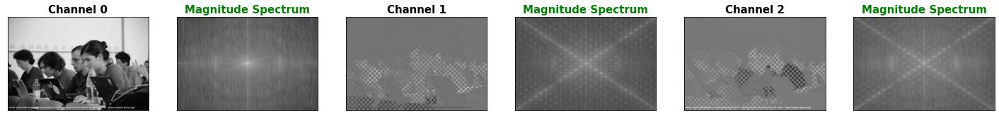

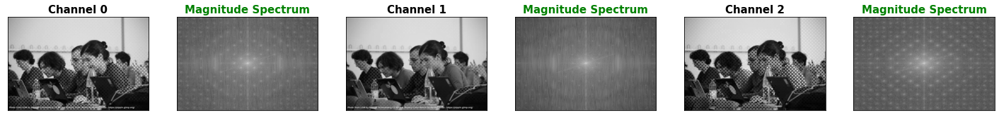

...

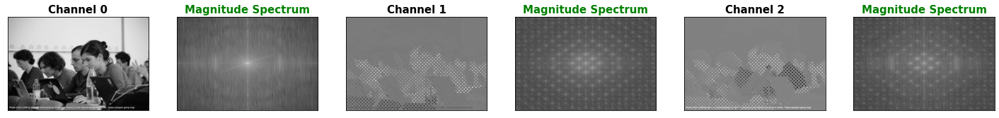

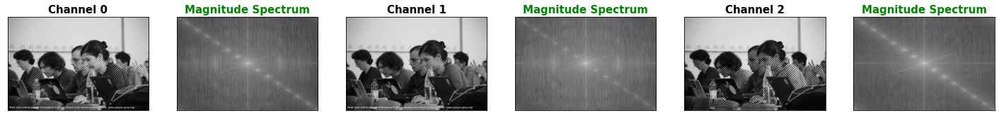

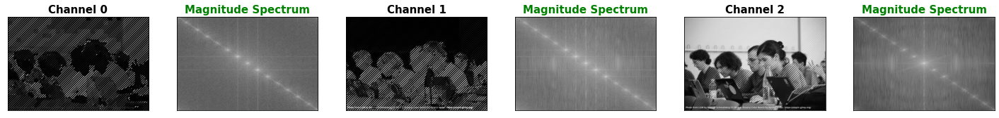

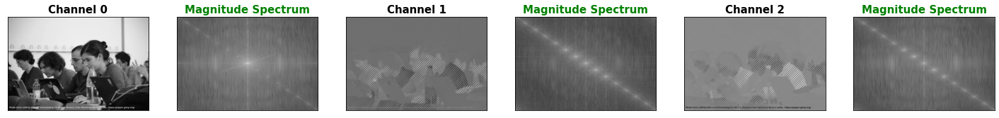

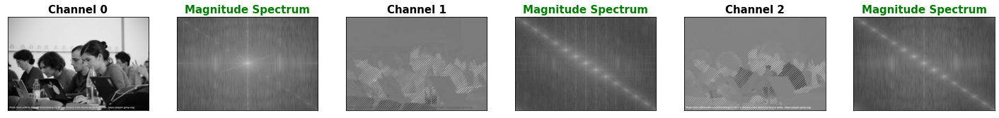

In [11]:
img_names = ["diagonal_gird.png", "dot_grid.png", "orthogonal_lines.png"]
for img_name in img_names:

    name=img_name.split(".")[0]
    img = cv2.imread(path+img_name)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # RGB image
    get_magnitude(inp_img=img, name=name+"_rgb")
    # HSV image
    img_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    get_magnitude(inp_img=img_hsv, name=name+"_hsv")
    # YCbCr image
    img_YCC = cv2.cvtColor(img, cv2.COLOR_RGB2YCR_CB)
    get_magnitude(inp_img=img_YCC, name=name+"_YCbCr")
    # lab image
    img_lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    get_magnitude(inp_img=img_lab, name=name+"_lab")



# B

In [12]:
def remove_pattern(channel_img, mask):
    dft = cv2.dft(np.float32(channel_img),flags = cv2.DFT_COMPLEX_OUTPUT)
    dft_shift = np.fft.fftshift(dft)
    fshift = dft_shift*mask
    f_ishift = np.fft.ifftshift(fshift)
    img_back = cv2.idft(f_ishift, flags=cv2.DFT_SCALE)
    img_back = cv2.magnitude(img_back[:,:,0],img_back[:,:,1])
    return img_back

In [13]:
def get_mask_for_horiz_line(magnitude, width):
    rows, cols = magnitude.shape
    crow,ccol = rows//2 , cols//2
    mask = np.zeros((rows,cols,2),np.uint8)
    magnitude_temp = magnitude.copy() 
    magnitude_temp[crow-width:crow+width, ccol-3*width:ccol+3*width] = 0
    dim_1_mask = magnitude_temp < np.percentile(magnitude_temp, 99.5)
    mask[:, :, 0] = dim_1_mask
    mask [:, :, 1] = dim_1_mask
    return mask

cagi_1_rgb


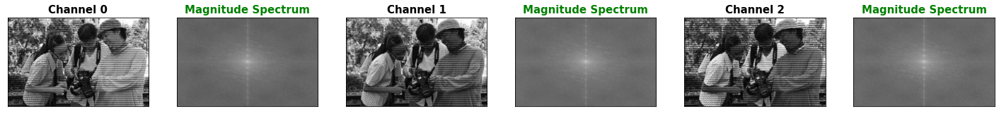

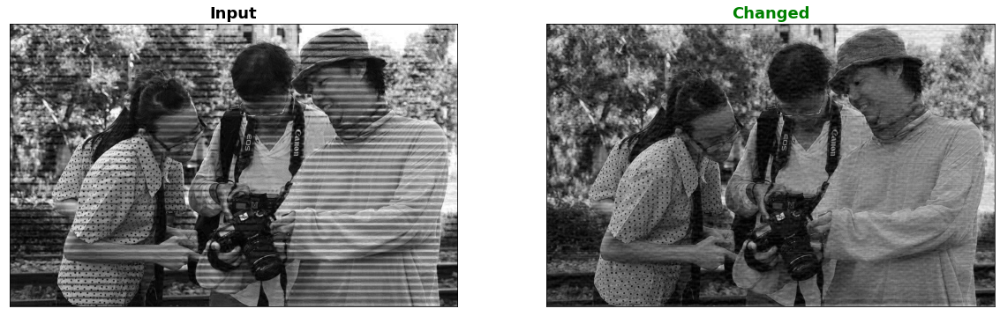

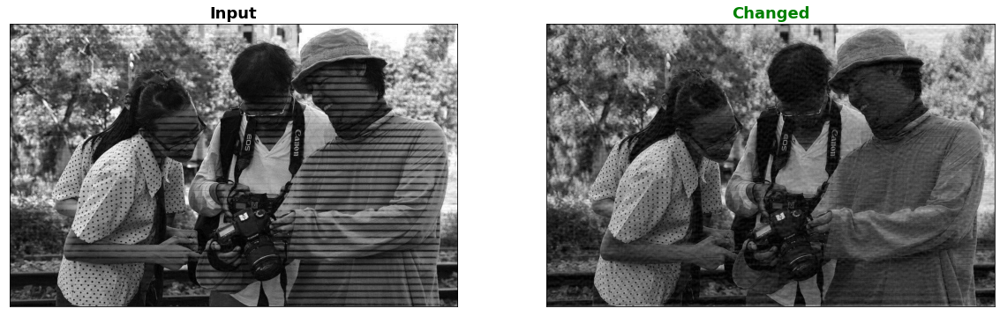

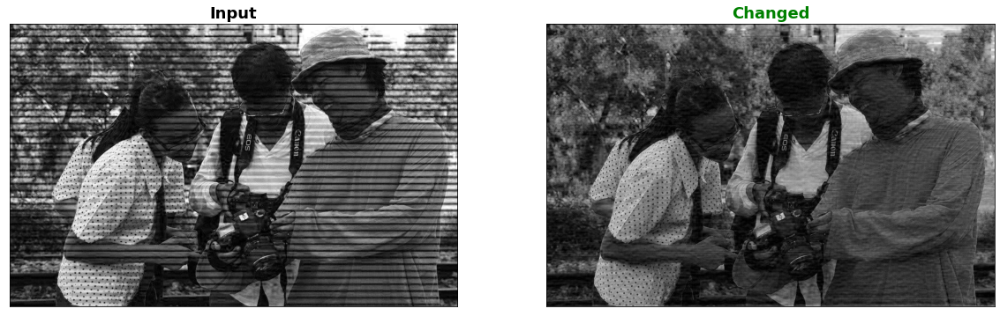

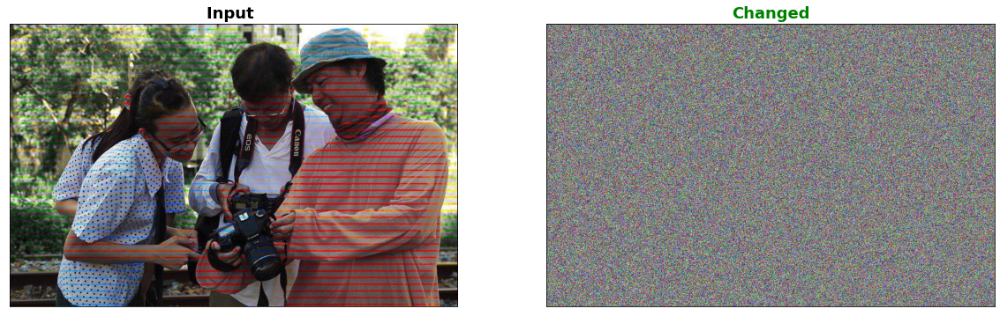

In [18]:
path = "b\\"
img_names = ["cagi_1.png"]
fontsize = 18
fg_color = 'black'
I_color = 'green'
font_dict_1 = {'fontsize': fontsize, 'color':fg_color, 'fontweight':'bold'}
font_dict_2 = {'fontsize': fontsize, 'color':I_color, 'fontweight':'bold'}
for img_name in img_names:
    name=img_name.split(".")[0]
    img = cv2.imread(path+img_name)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    magnitudes = get_magnitude(inp_img=img, name=name+"_rgb")
    rows, cols, channels = img.shape
    width = 35
    output_img = np.zeros((rows, cols, channels))
    for i in range(3): 
        plt.figure(figsize=(20, 7))
        magnitude = magnitudes[i]
        mask = get_mask_for_horiz_line(magnitude, width)
        img_back = remove_pattern(img[:, :, i], mask=mask)
        output_img[:, :, i] = img_back
        plt.subplot(121),plt.imshow(img[:, :, i], cmap = 'gray')
        plt.title('Input', fontdict=font_dict_1), plt.xticks([]), plt.yticks([])
        plt.subplot(122),plt.imshow(img_back, cmap = 'gray') 
        plt.title('Changed', fontdict=font_dict_2), plt.xticks([]), plt.yticks([])
        plt.savefig(name+"_ch_"+ str(i) + "reconstruct.png")
        plt.show()

    plt.figure(figsize=(20, 7))
    plt.subplot(121),plt.imshow(img, cmap = 'gray')
    plt.title('Input ', fontdict=font_dict_1), plt.xticks([]), plt.yticks([])
    output_img = (output_img*255.0).astype(np.uint8)
    plt.subplot(122),plt.imshow(output_img) 
    plt.title('Changed', fontdict=font_dict_2), plt.xticks([]), plt.yticks([])
    plt.savefig(name+ "_reconstruct.png")
    plt.show()
    plt.close()

In [19]:
def create_circular_mask(magnitude, radius):

    rows, cols = magnitude.shape
    mask = np.zeros((rows,cols,2),np.uint8)
    center_x,center_y = rows//2 , cols//2
    Y, X = np.ogrid[:cols, :rows]
    dist_from_center = np.sqrt((X - center_x)**2 + (Y-center_y)**2)
    dist_from_center = dist_from_center <= radius
    mask[:, :, 0] = dist_from_center
    mask[:, :, 1] = dist_from_center
   
    return mask

In [20]:
def get_mask_for_diagonal_line(magnitude, width, percentage=99.5):
    rows, cols = magnitude.shape
    crow,ccol = rows//2 , cols//2
    mask = np.zeros((rows,cols,2),np.uint8)
    magnitude_temp = magnitude.copy() 
    magnitude_temp[crow-width:crow+width, ccol-width:ccol+width] = 0
    dim_1_mask = magnitude_temp < np.percentile(magnitude_temp, percentage)
    mask[:, :, 0] = dim_1_mask
    mask [:, :, 1] = dim_1_mask
    return mask

cagi_3_rgb
cagi_3_hsv
cagi_3_YCbCr
cagi_3_lab
cagi_3_YCR_CB


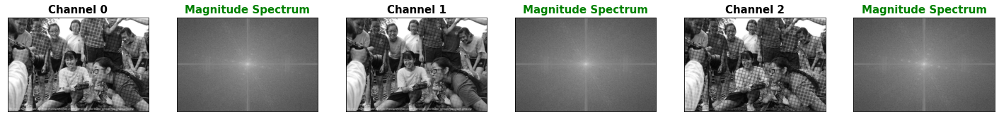

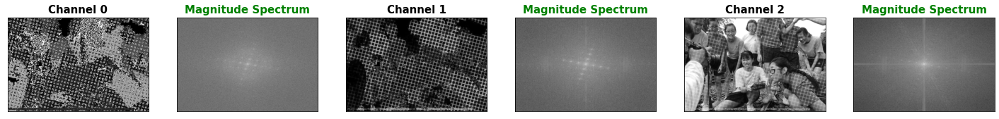

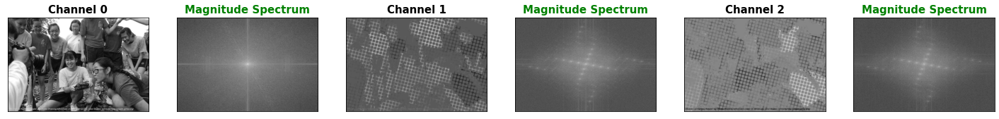

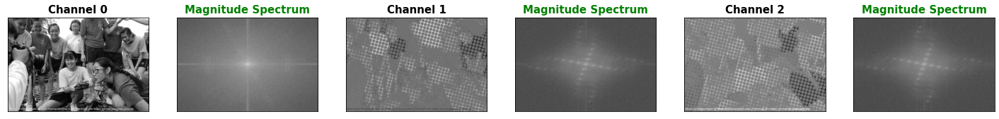

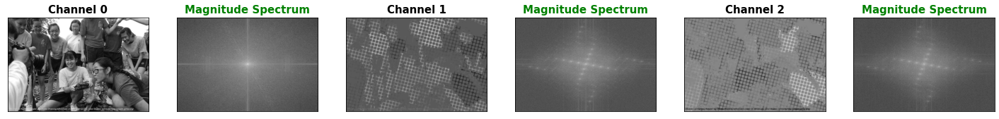

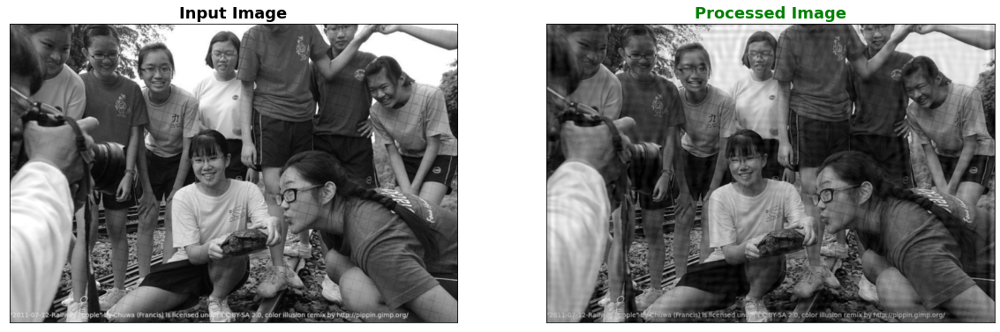

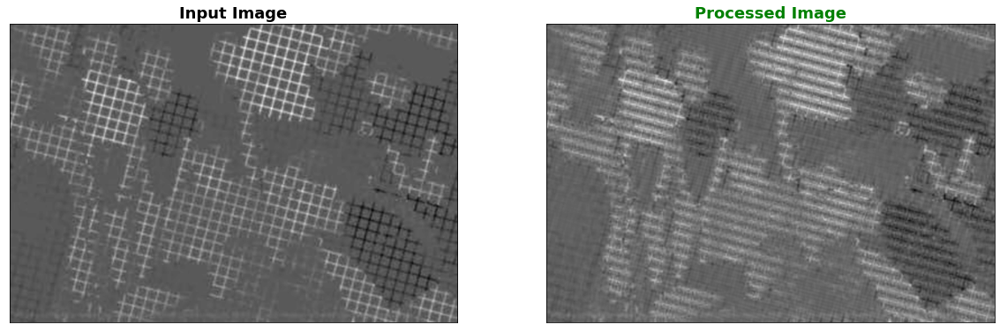

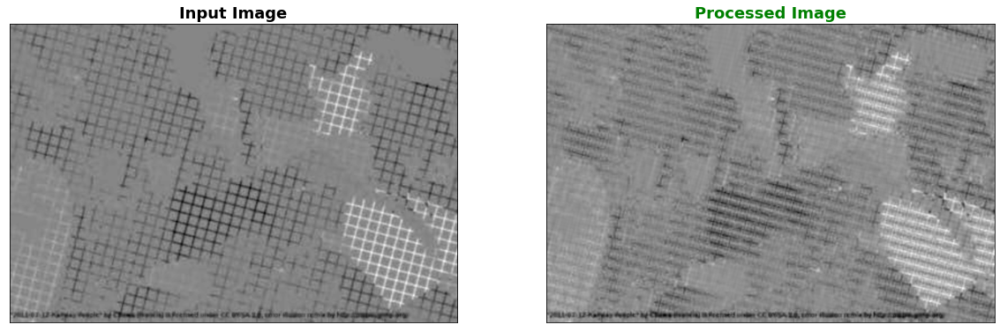

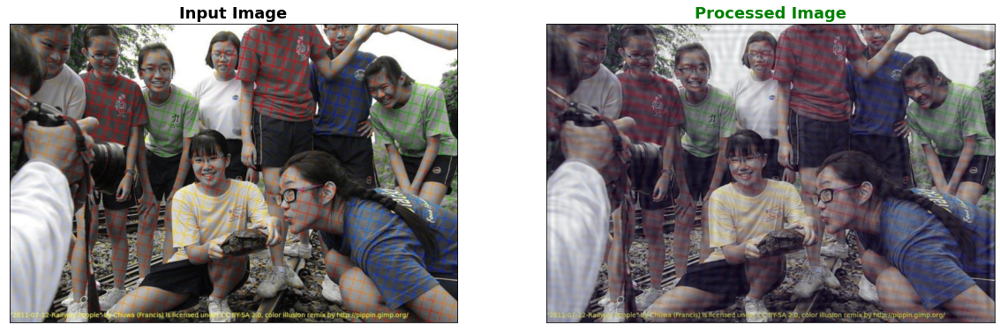

In [26]:
path = "b\\"
img_names = ["cagi_3.png"]
fontsize = 18
fg_color = 'black'
I_color = 'green'
font_dict_1 = {'fontsize': fontsize, 'color':fg_color, 'fontweight':'bold'}
font_dict_2 = {'fontsize': fontsize, 'color':I_color, 'fontweight':'bold'}
color_space = 'YCR_CB' # YCR_CB
for img_name in img_names:
    name=img_name.split(".")[0]
    img = cv2.imread(path+img_name)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # RGB image
    get_magnitude(inp_img=img, name=name+"_rgb")
    # HSV image
    img_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    get_magnitude(inp_img=img_hsv, name=name+"_hsv")
    # YCbCr image
    img_YCC = cv2.cvtColor(img, cv2.COLOR_RGB2YCR_CB)
    get_magnitude(inp_img=img_YCC, name=name+"_YCbCr")
    # lab image
    img_lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    get_magnitude(inp_img=img_lab, name=name+"_lab")

    img = cv2.cvtColor(img, cv2.COLOR_RGB2YCR_CB)

    magnitudes = get_magnitude(inp_img=img, name=name+"_"+color_space)

    rows, cols, channels = img.shape
    width = 33
    percentage = 99
    output_img = np.zeros((rows, cols, channels))
    for i in range(3): 
        plt.figure(figsize=(20, 7))
        magnitude = magnitudes[i]
        mask = get_mask_for_diagonal_line(magnitude, width, percentage)
        ksize = (10, 10)
        mask = cv2.blur(mask, ksize)

        img_back = remove_pattern(img[:, :, i], mask=mask)

        output_img[:, :, i] = img_back
        plt.subplot(121),plt.imshow(img[:, :, i], cmap = 'gray')
        plt.title('Input Image', fontdict=font_dict_1), plt.xticks([]), plt.yticks([])
        plt.subplot(122),plt.imshow(img_back, cmap = 'gray') 
        plt.title('Processed Image', fontdict=font_dict_2), plt.xticks([]), plt.yticks([])
        plt.savefig(name+"_ch_"+ str(i) + "reconstruct.png")
        plt.show()
    
    output_img = np.float32(output_img)
    if color_space == "RGB":
        pass
    elif color_space == 'HSV':
        img = cv2.cvtColor(img, cv2.COLOR_HSV2RGB)
        output_img = cv2.cvtColor(output_img, cv2.COLOR_HSV2RGB)
    elif color_space == 'YCR_CB':
        img = cv2.cvtColor(img, cv2.COLOR_YCR_CB2RGB)
        output_img = cv2.cvtColor(output_img, cv2.COLOR_YCR_CB2RGB)
    for ch in range(3):
        temp = output_img[:, :, ch]
        output_img[:, :, ch] = (temp-temp.min()) / (temp.max()-temp.min()) * 1.0
    output_img = (output_img*255.0).astype(np.uint8)
    plt.figure(figsize=(20, 7))
    plt.subplot(121),plt.imshow(img, cmap = 'gray')
    plt.title('Input Image', fontdict=font_dict_1), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(output_img) # , vmin=0, vmax=255
    plt.title('Processed Image', fontdict=font_dict_2), plt.xticks([]), plt.yticks([])
    plt.savefig(name+ "_reconstruct.png")
    plt.show()
    plt.close()

# C

In [30]:
def image_filtering(path, img_name, color_space, width, percentage, do_blure, ksize=None):
    fontsize = 18
    fg_color = 'black'
    I_color = 'green'
    font_dict_1 = {'fontsize': fontsize, 'color':fg_color, 'fontweight':'bold'}
    font_dict_2 = {'fontsize': fontsize, 'color':I_color, 'fontweight':'bold'}
    
    name=img_name.split(".")[0]
    img = cv2.imread(path+img_name)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)


    if color_space == "RGB":
        pass
    elif color_space == 'HSV':
        img = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    elif color_space == 'YCR_CB':
        img = cv2.cvtColor(img, cv2.COLOR_RGB2YCR_CB)
    else:
        img = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)


    magnitudes = get_magnitude(inp_img=img, name=name+"_"+color_space)

    rows, cols, channels = img.shape
    
    output_img = np.zeros((rows, cols, channels))
    for i in range(3): 
        plt.figure(figsize=(20, 7))
        magnitude = magnitudes[i]
        mask = get_mask_for_diagonal_line(magnitude, width, percentage)
        if do_blure:
            ksize = ksize
            mask = cv2.blur(mask, ksize)

        img_back = remove_pattern(img[:, :, i], mask=mask)

        output_img[:, :, i] = img_back
        plt.subplot(121),plt.imshow(img[:, :, i], cmap = 'gray', vmin=0.0, vmax=255.0)
        plt.title('Input Image', fontdict=font_dict_1), plt.xticks([]), plt.yticks([])
        plt.subplot(122),plt.imshow(img_back, cmap = 'gray',  vmin=0.0, vmax=255.0) 
        plt.title('Processed Image', fontdict=font_dict_2), plt.xticks([]), plt.yticks([])
        plt.savefig("d/"+name+"_ch_"+ str(i) + "reconstruct.png")
        plt.show()
    
    output_img = np.float32(output_img)
    if color_space == "RGB":
        pass
    elif color_space == 'HSV':
        img = cv2.cvtColor(img, cv2.COLOR_HSV2RGB)
        output_img = cv2.cvtColor(output_img, cv2.COLOR_HSV2RGB)
    elif color_space == 'YCR_CB':
        img = cv2.cvtColor(img, cv2.COLOR_YCR_CB2RGB)
        output_img = cv2.cvtColor(output_img, cv2.COLOR_YCR_CB2RGB)
    elif color_space == 'LAB':
        img = cv2.cvtColor(img, cv2.COLOR_LAB2RGB)
        output_img = cv2.cvtColor(output_img, cv2.COLOR_LAB2RGB)
    for ch in range(3):
        temp = output_img[:, :, ch]
        output_img[:, :, ch] = (temp-temp.min()) / (temp.max()-temp.min()) * 1.0
    output_img = (output_img*255.0).astype(np.uint8)
    plt.figure(figsize=(20, 7))
    plt.subplot(121),plt.imshow(img, cmap = 'gray')
    plt.title('Input Image', fontdict=font_dict_1), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(output_img) # , vmin=0, vmax=255
    plt.title('Processed Image', fontdict=font_dict_2), plt.xticks([]), plt.yticks([])
    plt.savefig("d/"+name+ "_reconstruct.png")
    plt.show()
    plt.close()

**part c: image: munker_hearts.png**

munker_hearts_YCR_CB


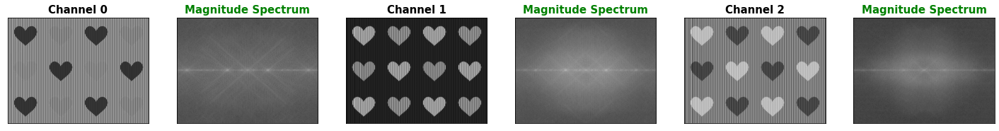

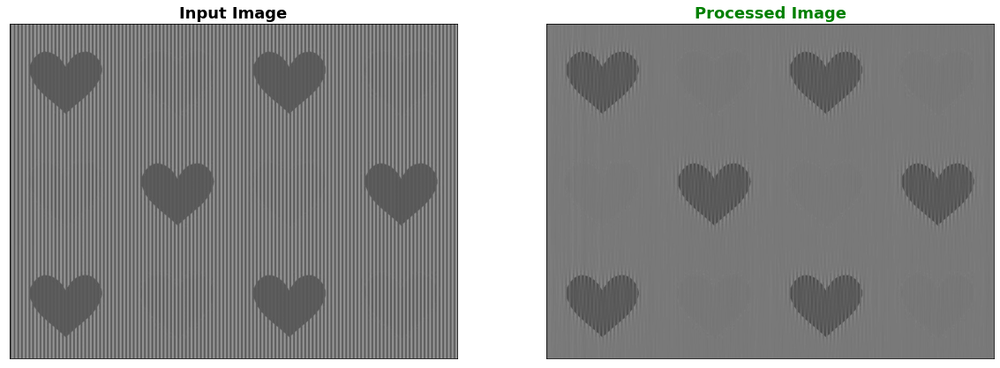

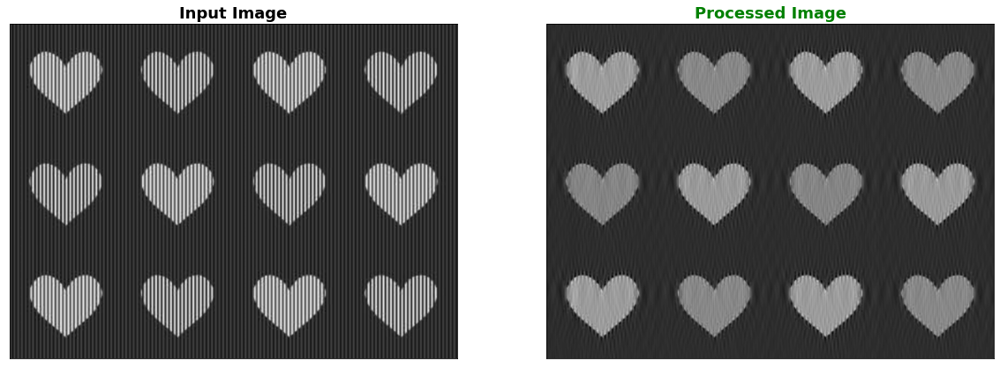

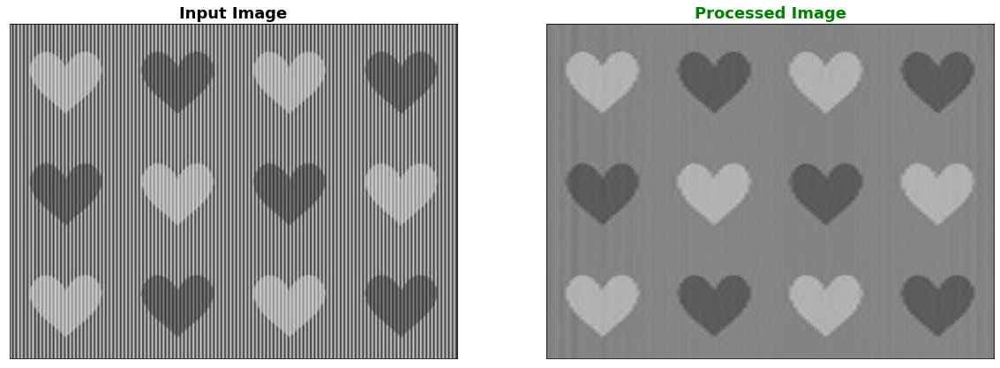

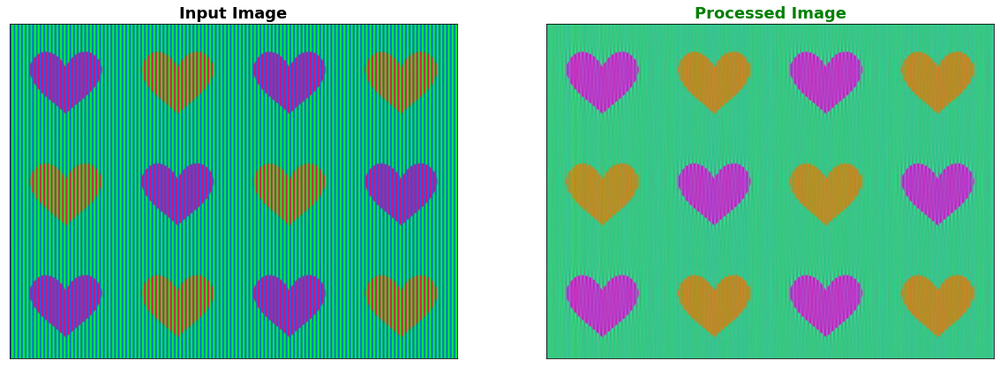

In [31]:
path = "c\\"
img_name = "munker_hearts.png"
color_space = 'YCR_CB' 
width = 30
percentage = 95
do_blure = True
ksize=(10, 10)

image_filtering(path, img_name, color_space, width, percentage, do_blure, ksize)




munker_spheres_1_RGB


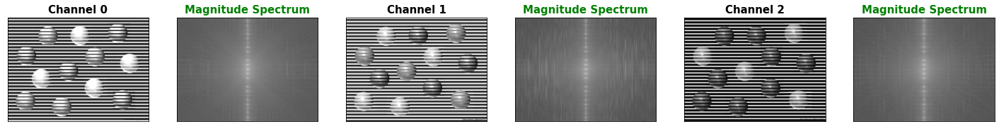

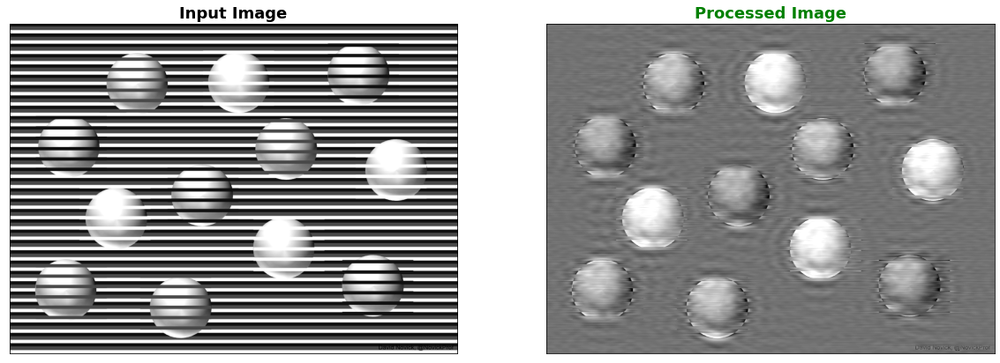

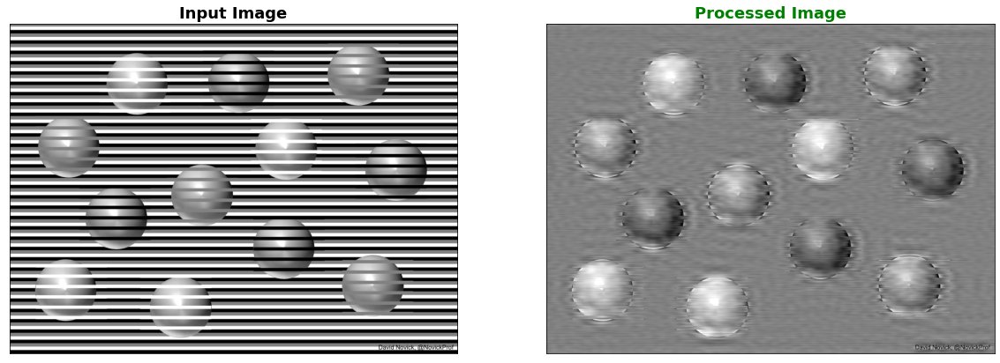

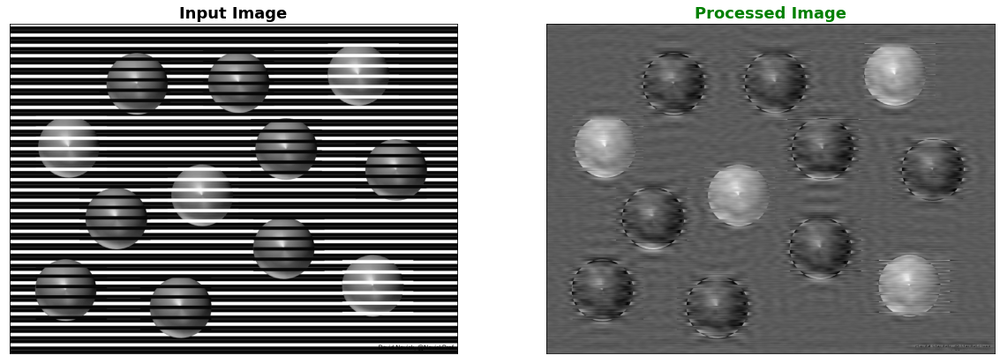

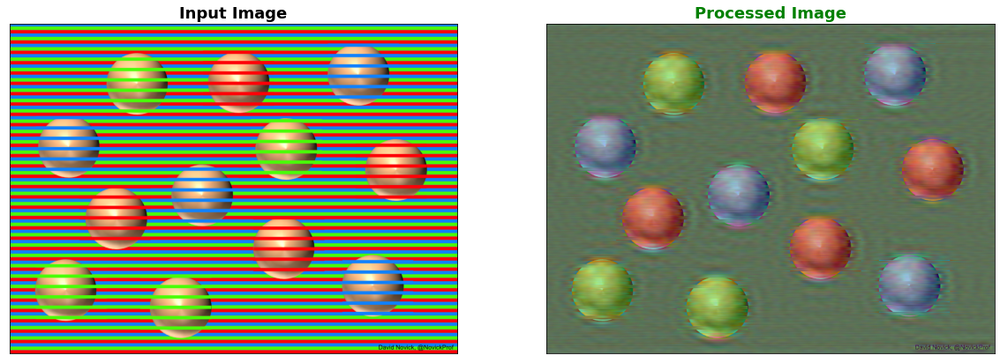

In [32]:
path = "c\\"
img_name = "munker_spheres_1.png"
color_space = 'RGB'  # YCR_CB
width = 24
percentage = 98.5
do_blure = True
ksize=(5, 5)

image_filtering(path, img_name, color_space, width, percentage, do_blure, ksize)

munker_spheres_2_RGB


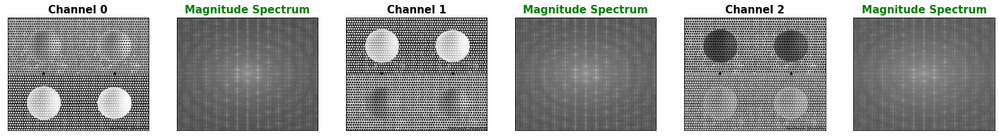

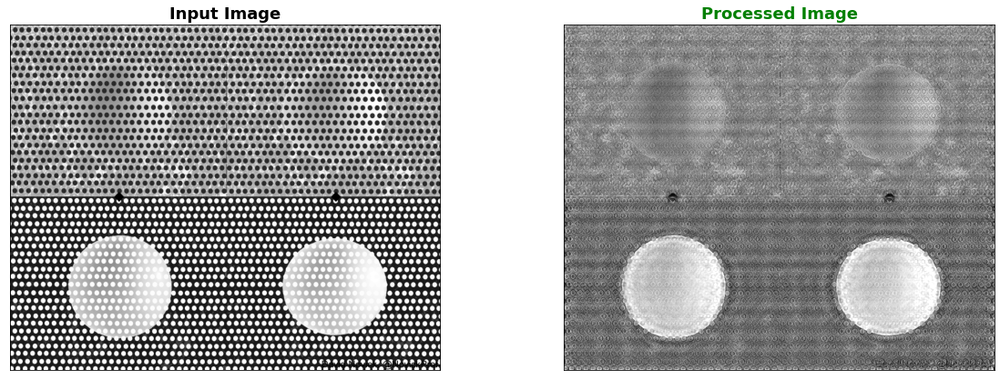

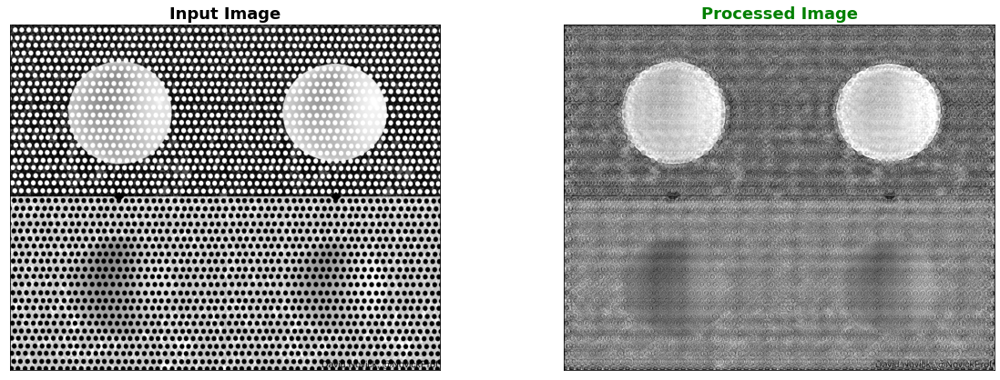

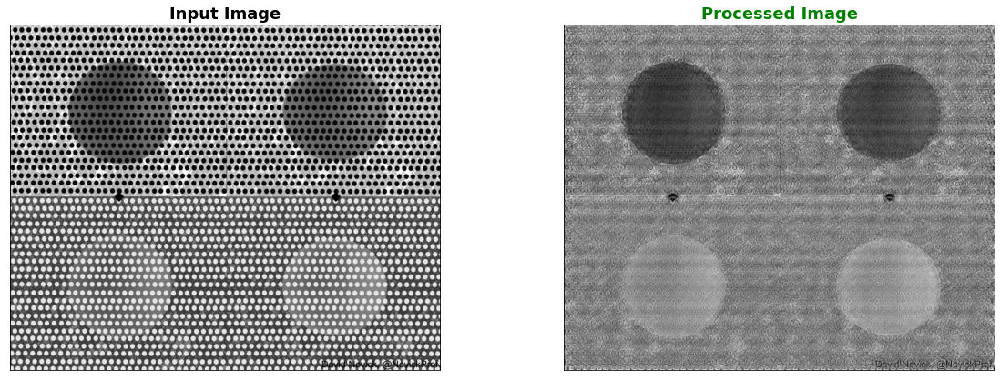

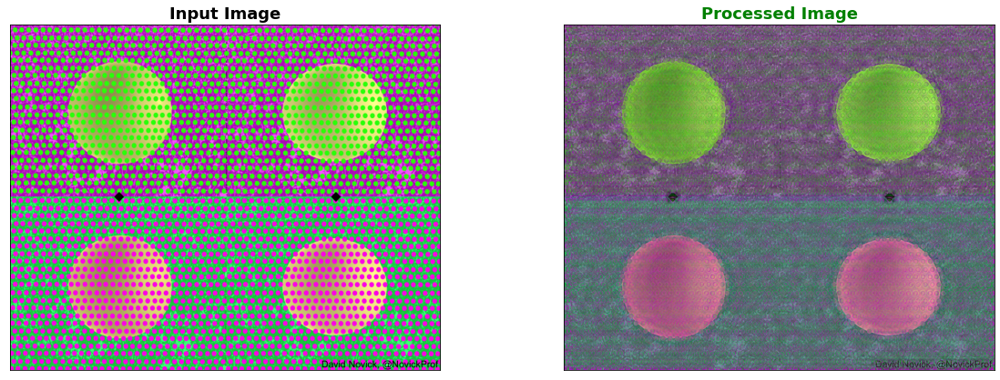

In [33]:
path = "c\\"
img_name = "munker_spheres_2.png"
color_space = 'RGB'  # YCR_CB
width = 30
percentage = 94
do_blure = True
ksize=(8, 8)

image_filtering(path, img_name, color_space, width, percentage, do_blure, ksize)

munker_zigzag_lines_rgb
munker_zigzag_lines_hsv
munker_zigzag_lines_YCbCr
munker_zigzag_lines_lab
munker_zigzag_lines_YCR_CB


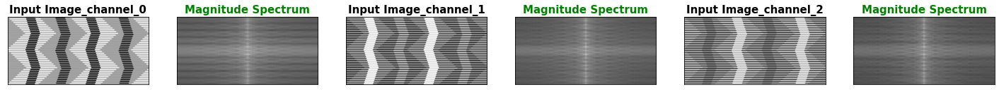

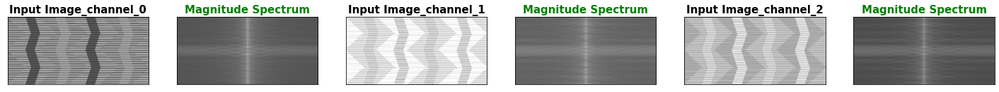

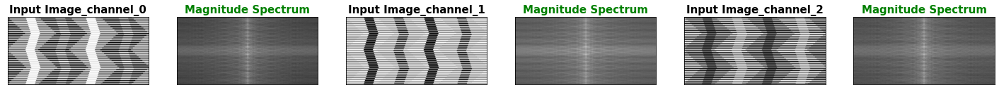

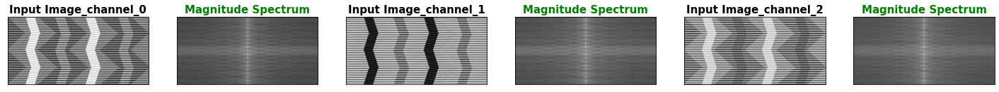

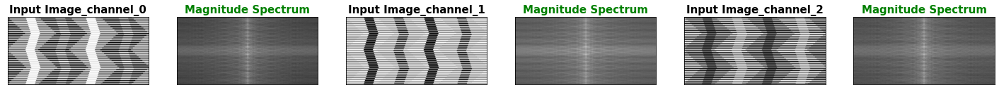

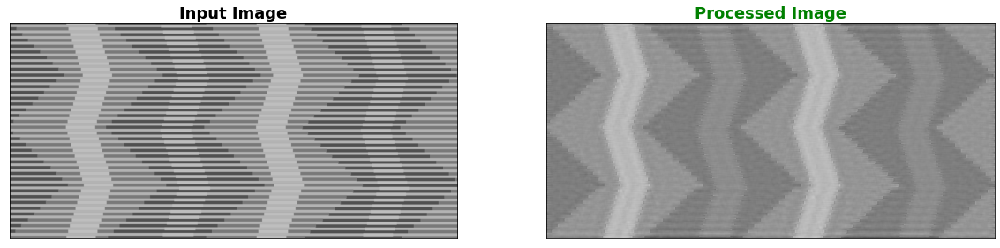

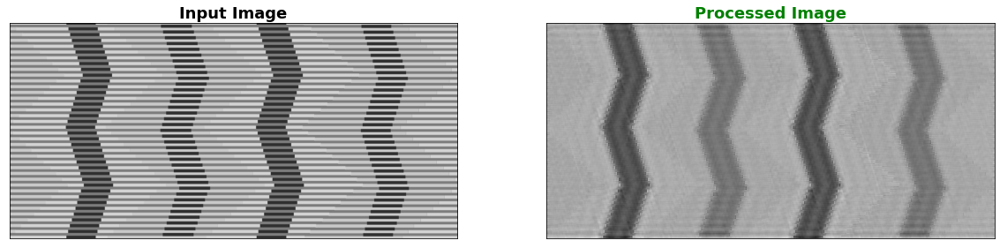

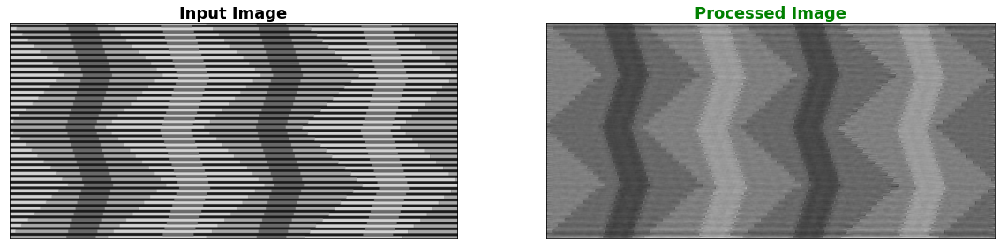

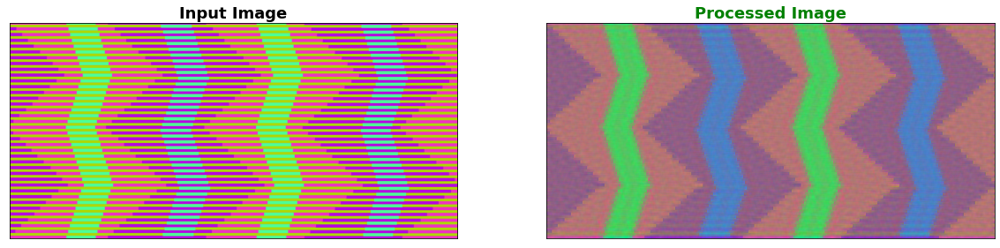

In [101]:
path = "inputs\P4\\c\\"
img_name = "munker_zigzag_lines.png"
color_space = 'YCR_CB'  # YCR_CB
width = 28
percentage = 94
do_blure = True
ksize=(2, 2)

image_filtering(path, img_name, color_space, width, percentage, do_blure, ksize)

# D

munker_cubes_rgb
munker_cubes_hsv
munker_cubes_YCbCr
munker_cubes_lab
munker_cubes_YCR_CB


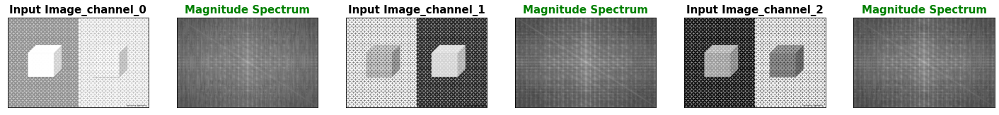

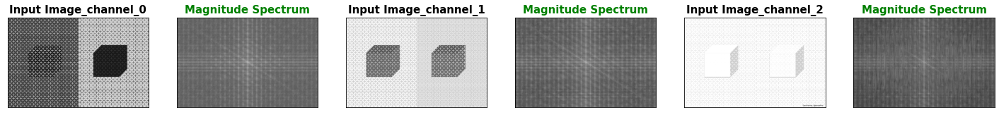

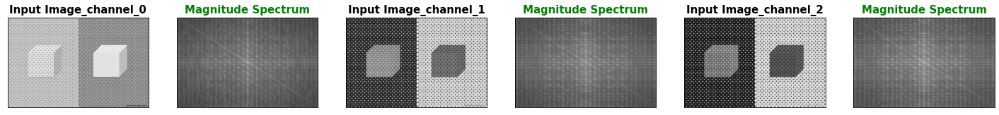

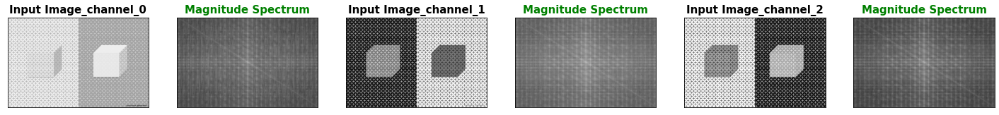

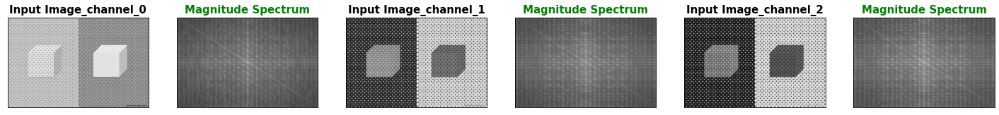

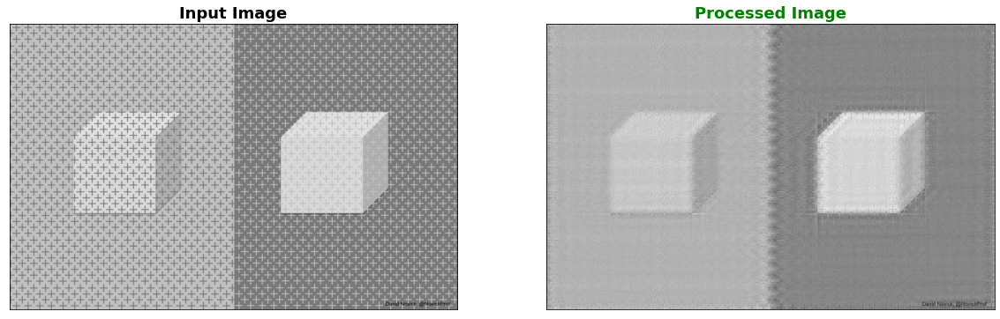

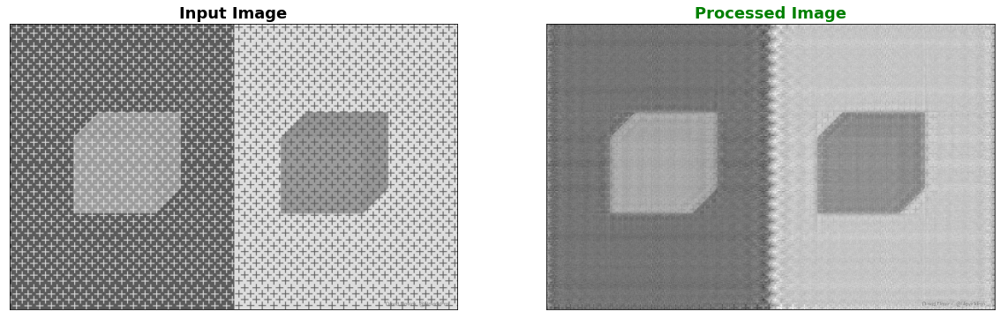

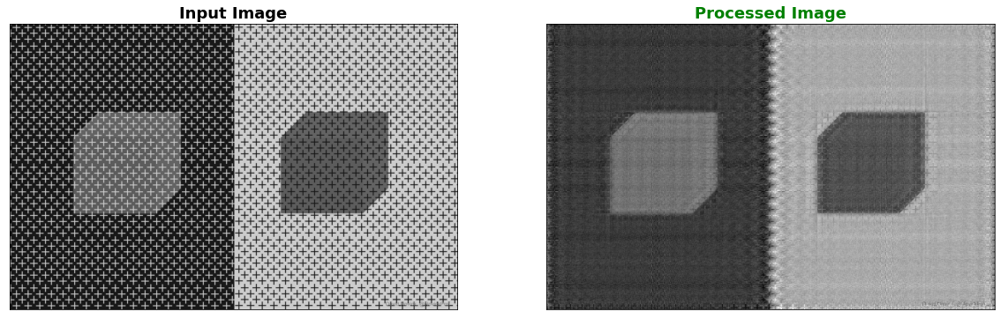

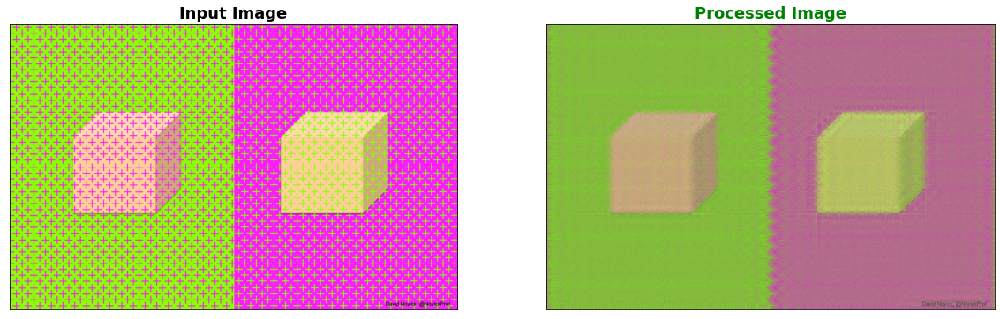

In [119]:
path = "d\\"
img_name = "munker_cubes.png"
color_space = 'YCR_CB'  # YCR_CB
width = 30
percentage = 98.5
do_blure = False
ksize=(10, 10)

image_filtering(path, img_name, color_space, width, percentage, do_blure, ksize)

munker_hears_2_YCR_CB


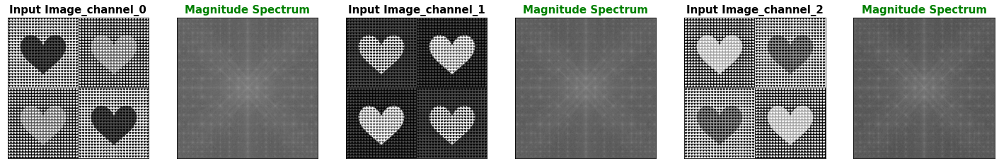

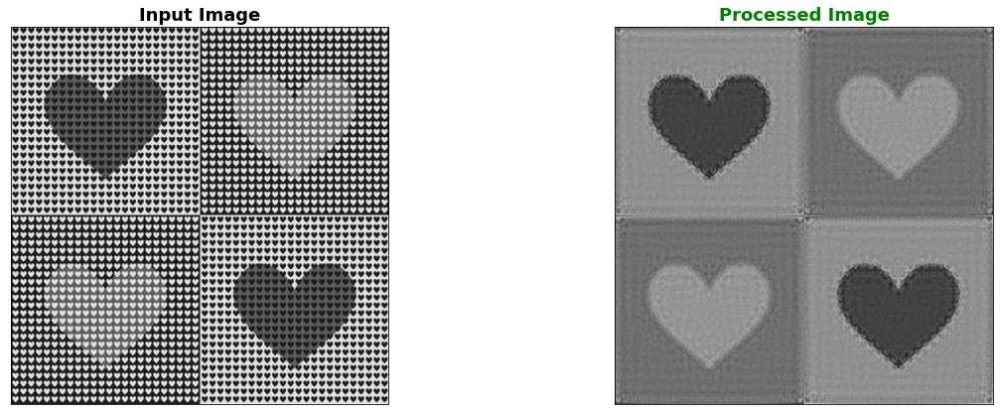

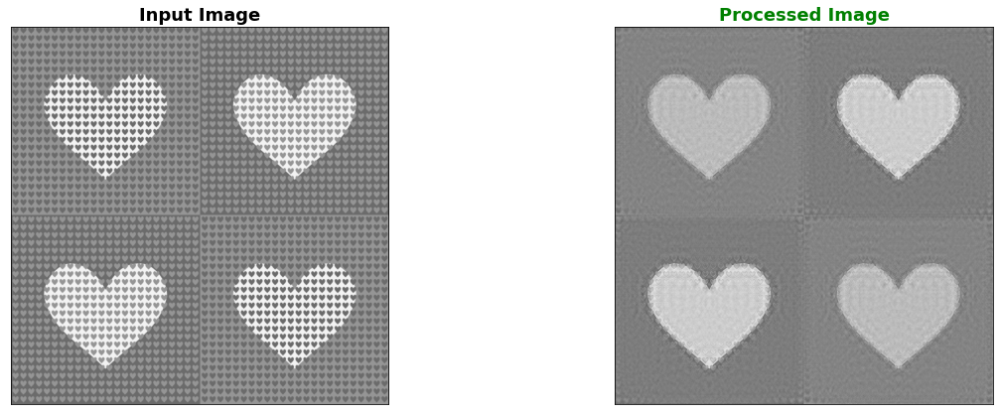

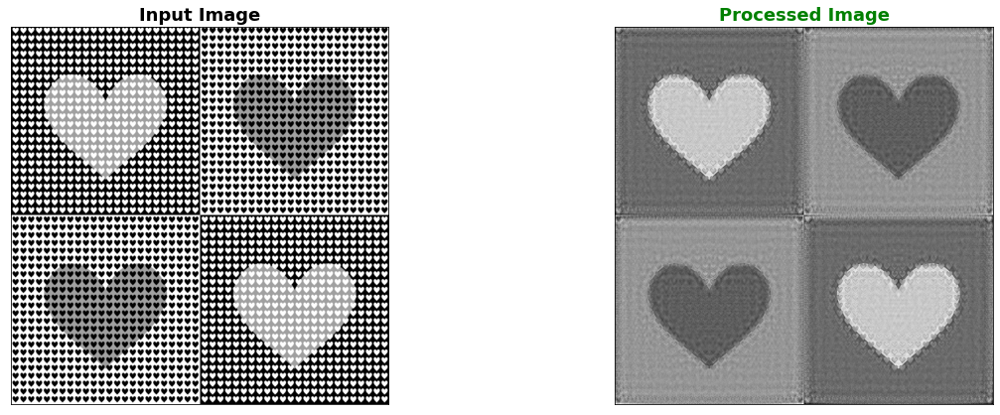

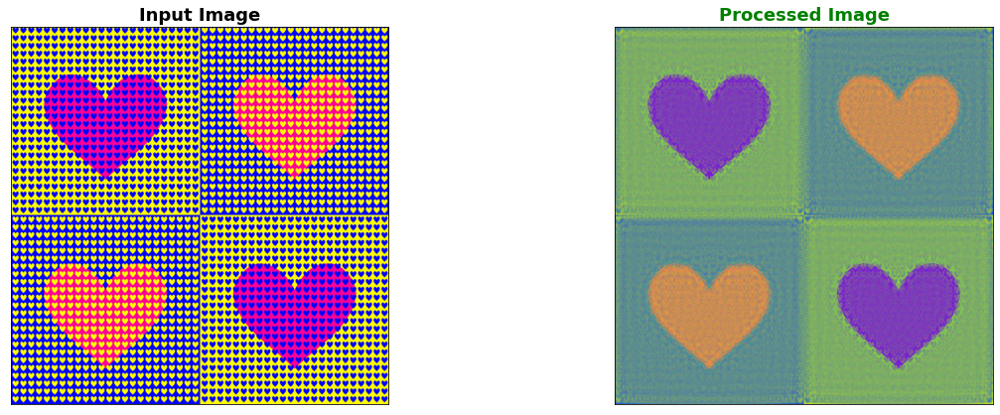

In [178]:
path = "d\\"
img_name = "munker_hears_2.png"
color_space = 'YCR_CB'  # YCR_CB
width = 35
percentage = 99
do_blure = False
ksize=(50, 50)

image_filtering(path, img_name, color_space, width, percentage, do_blure, ksize)

munker_monspiral_RGB


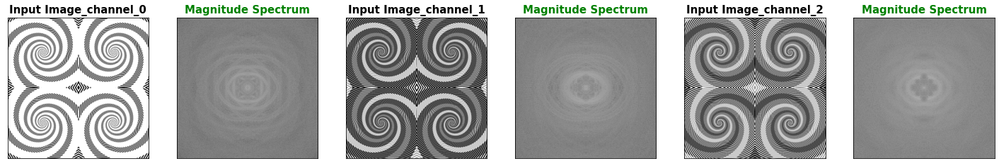

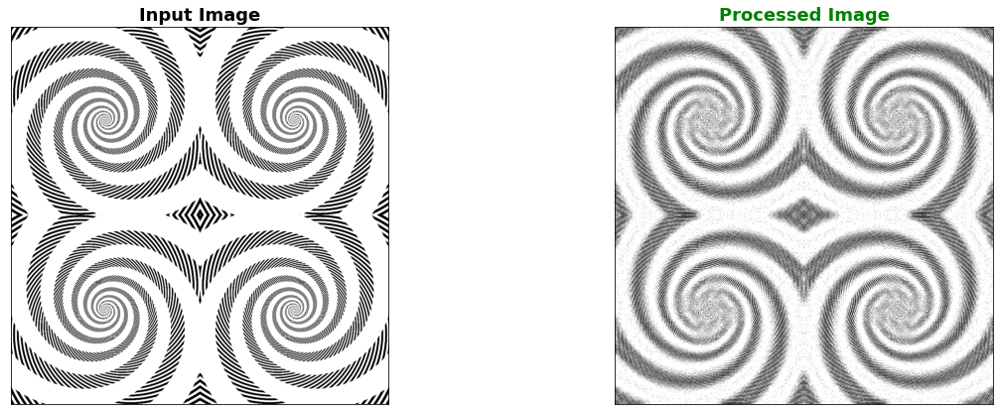

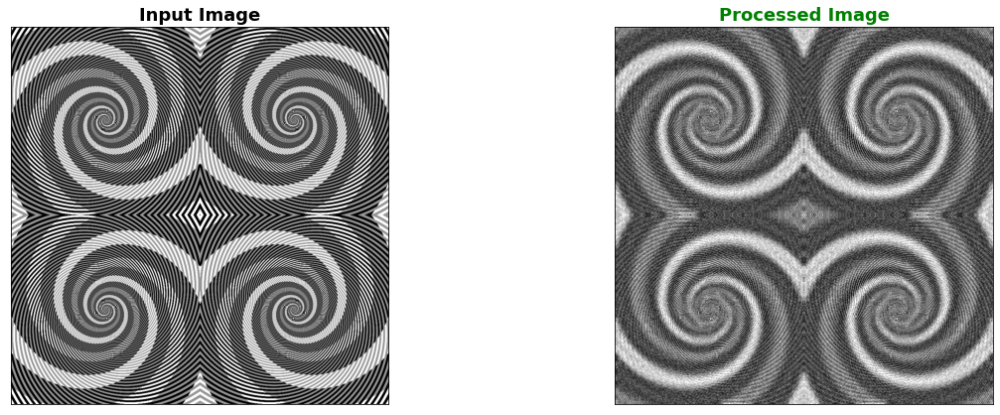

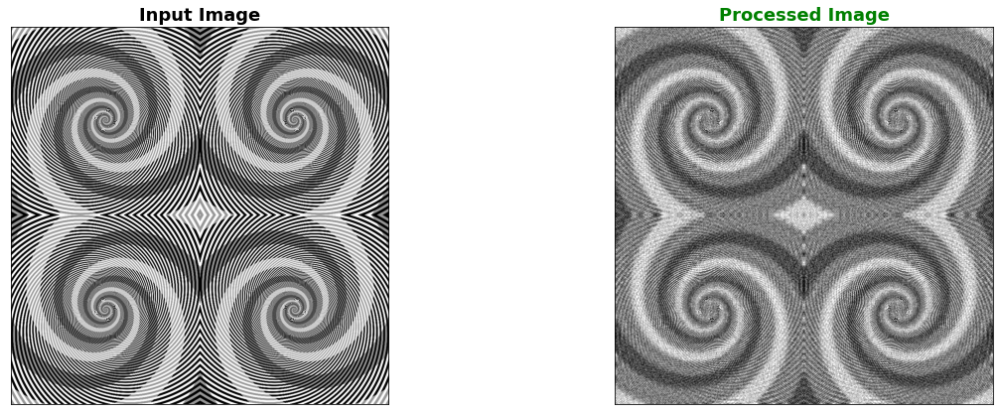

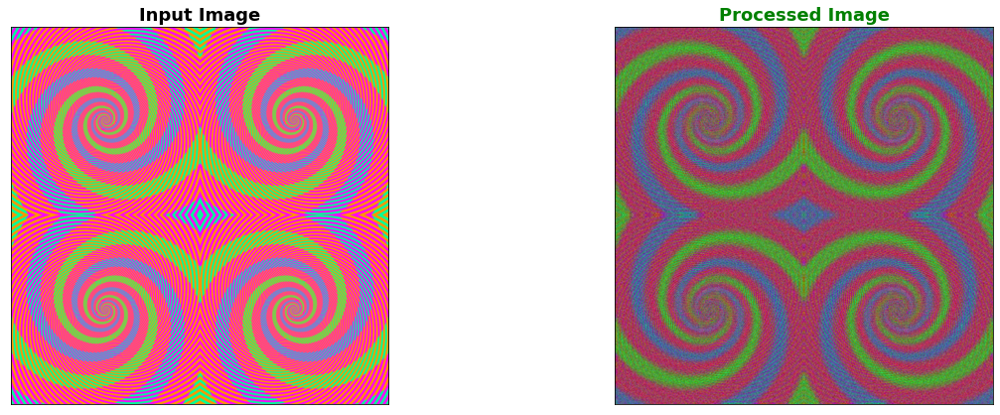

In [172]:

path = "d\\"
img_name = "munker_monspiral.png"
color_space = 'RGB'  # YCR_CB
width = 30
percentage = 97
do_blure = False
ksize=(20, 20)

image_filtering(path, img_name, color_space, width, percentage, do_blure, ksize)